In [6]:
import csv
import numpy as np


def read_csv_file(filename):
    coordinates = []

    with open(filename, 'r') as file:
        reader = csv.DictReader(file)
        for row in reader:
            x = float(row['X (nm)'])
            y = float(row['Y (nm)'])
            coordinates.append([x, y])
    
    return np.array(coordinates)



filename = "ONI RESULTS_4.csv" 
coordinates = read_csv_file(filename)




(1171550, 2)


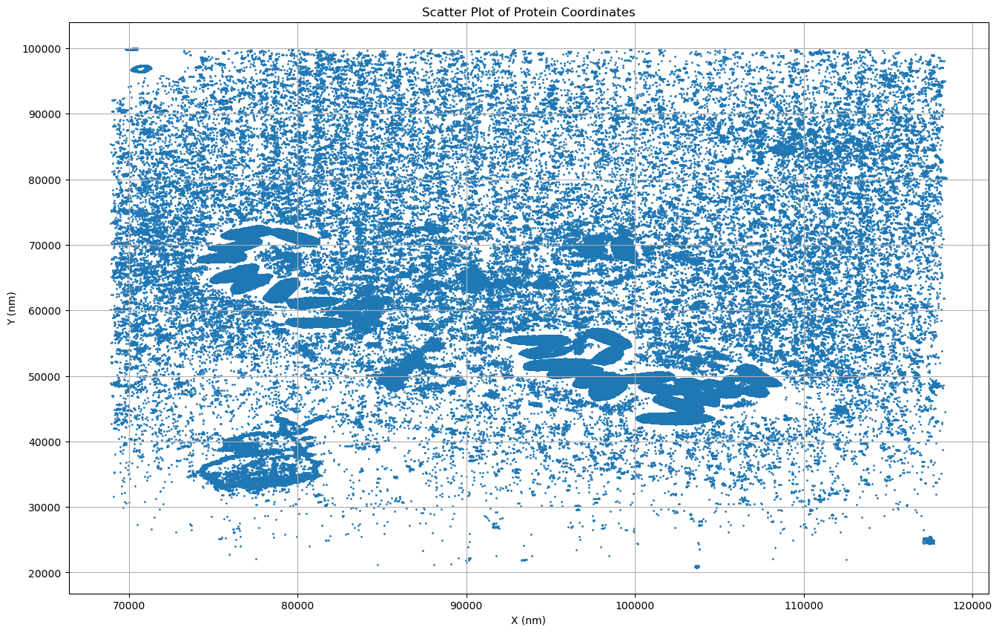

In [7]:
import numpy as np
import matplotlib.pyplot as plt

# from sklearn.preprocessing import StandardScaler

# scaler = StandardScaler()
# coordinates = scaler.fit_transform(coordinates)

print(coordinates.shape)
def plotar(coordinates=coordinates,s=1,alpha=1):
    plt.figure(figsize=(16, 10))
    plt.scatter(coordinates[:, 0], coordinates[:, 1], s=s, alpha=alpha)
    plt.title('Scatter Plot of Protein Coordinates')
    plt.xlabel('X (nm)')
    plt.ylabel('Y (nm)')
    plt.grid(True)
    plt.show()
plotar()

0.08535700567624088
(100000, 2)


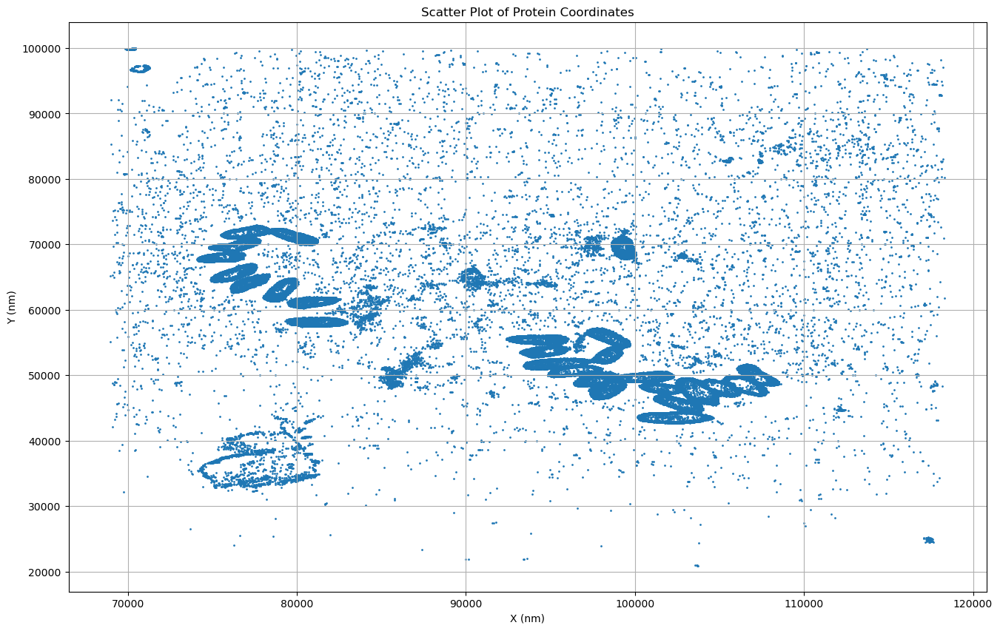

In [8]:
def fractionize(coordinates,num_points=pow(10,5)):

    fraction=min(1*num_points / coordinates.shape[0] ,1)
    print(fraction)
    num_vectors_to_return = int(fraction * len(coordinates))
    indices = np.linspace(0, len(coordinates) - 1, num=num_vectors_to_return, endpoint=True, dtype=int)

    # Return the selected vectors

    coordinates_frac=coordinates[indices]

    return coordinates_frac
coordinates_frac=fractionize(coordinates)
print(coordinates_frac.shape)

plotar(coordinates_frac)

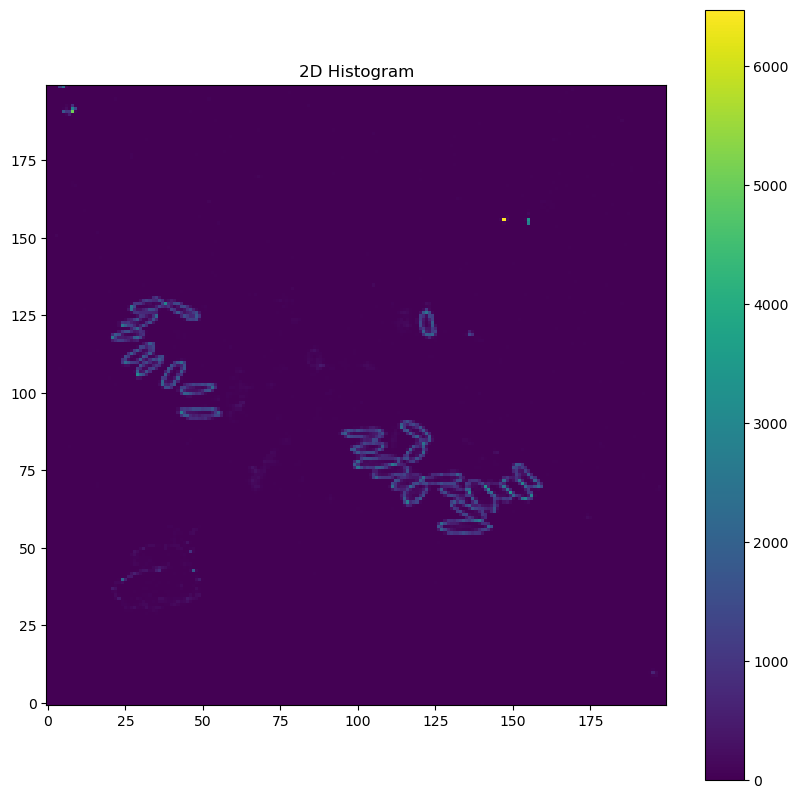

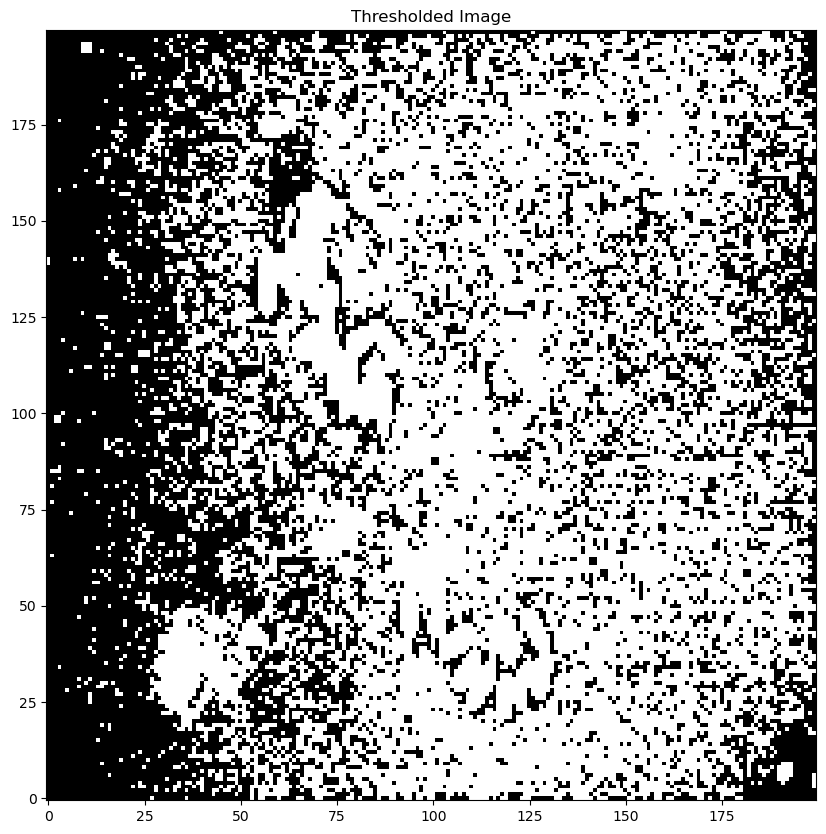

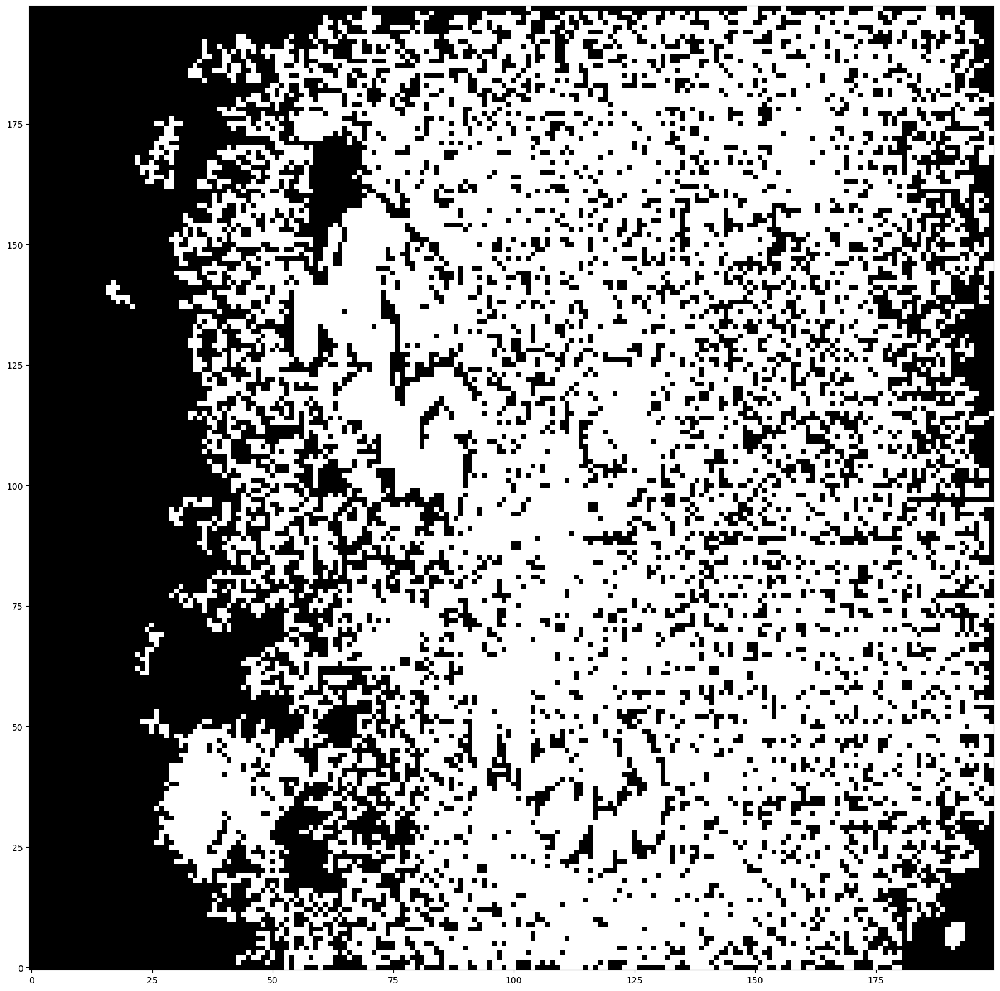

In [9]:
import numpy as np
import cv2
from skimage.morphology import dilation, disk,erosion
import matplotlib.pyplot as plt


# Convert your point data into a 2D histogram
hist, xedges, yedges = np.histogram2d(coordinates[:,0], coordinates[:,1], bins=(200,200))
bin_width_x=np.max(coordinates[:,0])
bin_width_y=np.max(coordinates[:,1])


#print(bin_width)

plt.figure(figsize=(10,10))
plt.imshow(hist.T, origin='lower')
plt.title('2D Histogram')
plt.colorbar()
plt.show()

# Threshold the histogram to create a binary image
# Adjust the threshold value based on your data
thresh = np.where(hist > 0, 255, 0).astype(np.uint8)

plt.figure(figsize=(10,10))
plt.imshow(thresh, cmap='gray', origin='lower')
plt.title('Thresholded Image')
plt.show()

#filtered=thresh
#Reduce noise
# Perform connected component analysis
# se=disk(1)
# thresh=dilation(thresh, se)
# #thresh=dilation(thresh, se)
# thresh=erosion(thresh, se)


#thresh=dilation(thresh, se)
#thresh=erosion(thresh, se)


num_labels, labels = cv2.connectedComponents(thresh)

# Initialize an empty image
filtered = np.zeros_like(thresh)

# Define the minimum area
min_area = 10  # adjust this based on your data

# Iterate through the unique labels (connected components)
for label in range(1, num_labels):
    component = np.where(labels == label, 255, 0).astype('uint8')

    if cv2.countNonZero(component) > min_area:
        filtered = cv2.bitwise_or(filtered, component)
#filtered=(filtered.astype(np.uint16) * 257)
# Show the filtered image
plt.figure(figsize=(20,20))
plt.imshow(filtered, cmap='gray', origin='lower')
plt.show()




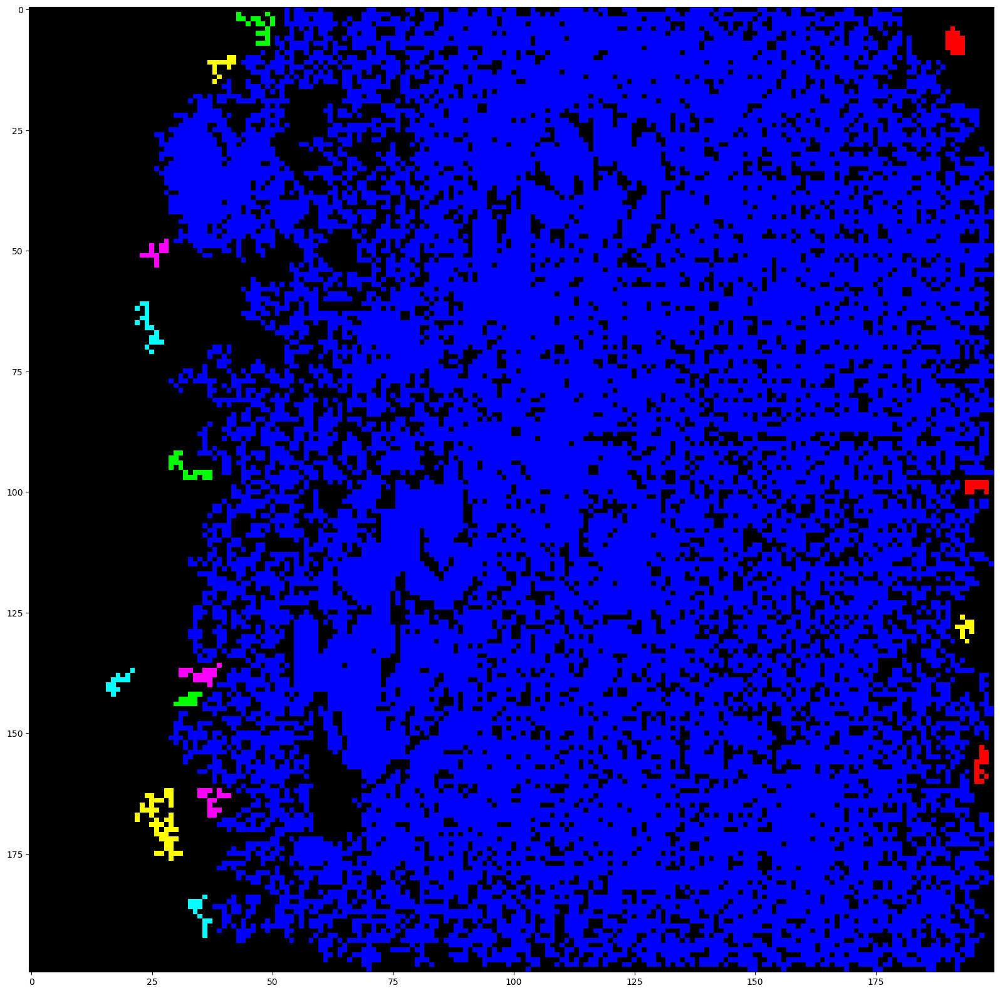

In [10]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from skimage.measure import label, regionprops
from skimage.morphology import dilation, disk

# Perform connected component analysis on the filtered image
filtered_labels = label(filtered)

# Get properties of the filtered regions
boundary_regions = regionprops(filtered_labels)

# Create a disk-shaped structuring element for the dilation
se = disk(0)

# Prepare the image for visualizing the ellipses (converted to 3 channels)
ellipse_img = cv2.cvtColor(filtered.copy(), cv2.COLOR_GRAY2BGR)

# Initialize color index
color_index = 0

# Define some colors for visualization (BGR format)
colors = [(0, 0, 255), (0, 255, 0), (255, 0, 0), (255, 255, 0), (255, 0, 255), (0, 255, 255)]

dilated_boundary_img=[]

min_area=10
max_area=90000

# Iterate over the filtered regions
for region in boundary_regions:
    # Perform ellipse fitting and size filtering
    if region.area >= min_area and region.area <= max_area:
        y0, x0 = region.centroid
        orientation = region.orientation
        x_radius = region.major_axis_length / 2.
        y_radius = region.minor_axis_length / 2.

        # Dilation of the individual region
        region_img = np.zeros_like(filtered)
        region_img[filtered_labels == region.label] = 255
        dilated_boundary_img.append(dilation(region_img, se))
        #dilated_region_img = dilation(region_img, se)


        # Draw the dilated region on the ellipse image
        ellipse_img[dilated_boundary_img[-1] > 0] = colors[color_index % len(colors)]

        # Draw the ellipse on the image
        ellipse = ((x0, y0), (x_radius, y_radius), np.degrees(orientation))
        #cv2.ellipse(ellipse_img, ellipse, (0, 0, 0), 2)

        # Increment color index
        color_index += 1

# Display the image
plt.figure(figsize=(20,20))

plt.imshow(ellipse_img)
plt.show()


(22626, 2)
(19, 2)
(19, 2)
(13, 2)
(13, 2)
(19, 2)
(22, 2)
(19, 2)
(13, 2)
(11, 2)
(19, 2)
(13, 2)
(14, 2)
(12, 2)
(15, 2)
(49, 2)
(17, 2)
(14, 2)
(40, 2)


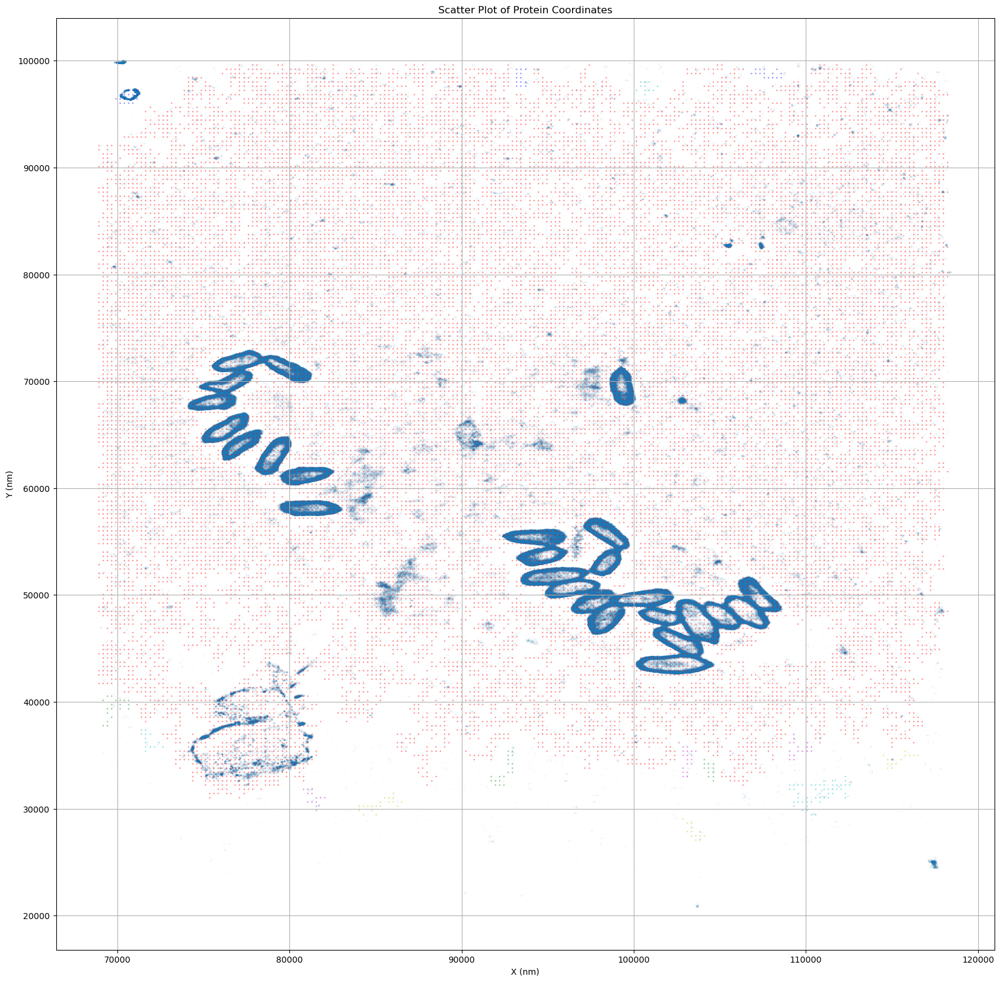

19


In [11]:
def Image_To_Coordinates(Region,xedges=xedges,yedges=yedges):
    # Find the pixel indices where the filtered image is white
    indices = np.where(Region == 255)

    # Map the pixel indices back to the original coordinates
    x_coords = xedges[indices[0]]
    y_coords = yedges[indices[1]]

    # Stack the x and y coordinates
    coordinates = np.vstack((x_coords, y_coords)).T
    coordinates = np.vstack((x_coords, y_coords)).T


    #plotar(coordinates,alpha=1)
    print(coordinates.shape)

    return coordinates

cell_grided_coordinates=[]
for i,region in enumerate(dilated_boundary_img):
    cell_grided_coordinates.append(Image_To_Coordinates(dilated_boundary_img[i]))


import matplotlib.pyplot as plt

def plot_coordinates_on_image(Raw_data, cell_coordinates):
    """
    Plots cell coordinates on top of an image, with each set of coordinates in a different color.
    Args:
    image: numpy array of shape (height, width) representing the original image
    cell_coordinates: list of numpy arrays, where each array is of shape (n, 2) and contains the (x, y) coordinates of a cell
    """
    # Plot the original image
    plt.figure(figsize=(20, 20))
    plt.scatter(Raw_data[:, 0], Raw_data[:, 1], s=0.1, alpha=0.1)
    plt.title('Scatter Plot of Protein Coordinates')
    plt.xlabel('X (nm)')
    plt.ylabel('Y (nm)')
    plt.grid(True)
    #plt.show()
    
    # Define some colors for the plot
    colors = ['r', 'g', 'b', 'c', 'm', 'y']
    
    # Plot each set of cell coordinates in a different color
    for i, coordinates in enumerate(cell_coordinates):
        plt.scatter(coordinates[:, 0], coordinates[:, 1], c=colors[i % len(colors)], s=0.1)

    plt.show()

# Call the function with your data
plot_coordinates_on_image(coordinates, cell_grided_coordinates)
print(len(cell_grided_coordinates))

#plt.figure(figsize=(20,20))

# plt.imshow(dilated_region_img[0])
# plt.show()

(365152, 2)
(5, 2)
(5610, 2)
(3, 2)
(14, 2)
(4, 2)
(8, 2)
(4, 2)
(10, 2)
(16, 2)
(12, 2)
(8, 2)
(7, 2)
(11, 2)
(4, 2)
(23, 2)
(10, 2)
(31, 2)
(21, 2)
Media, 19523.842105263157


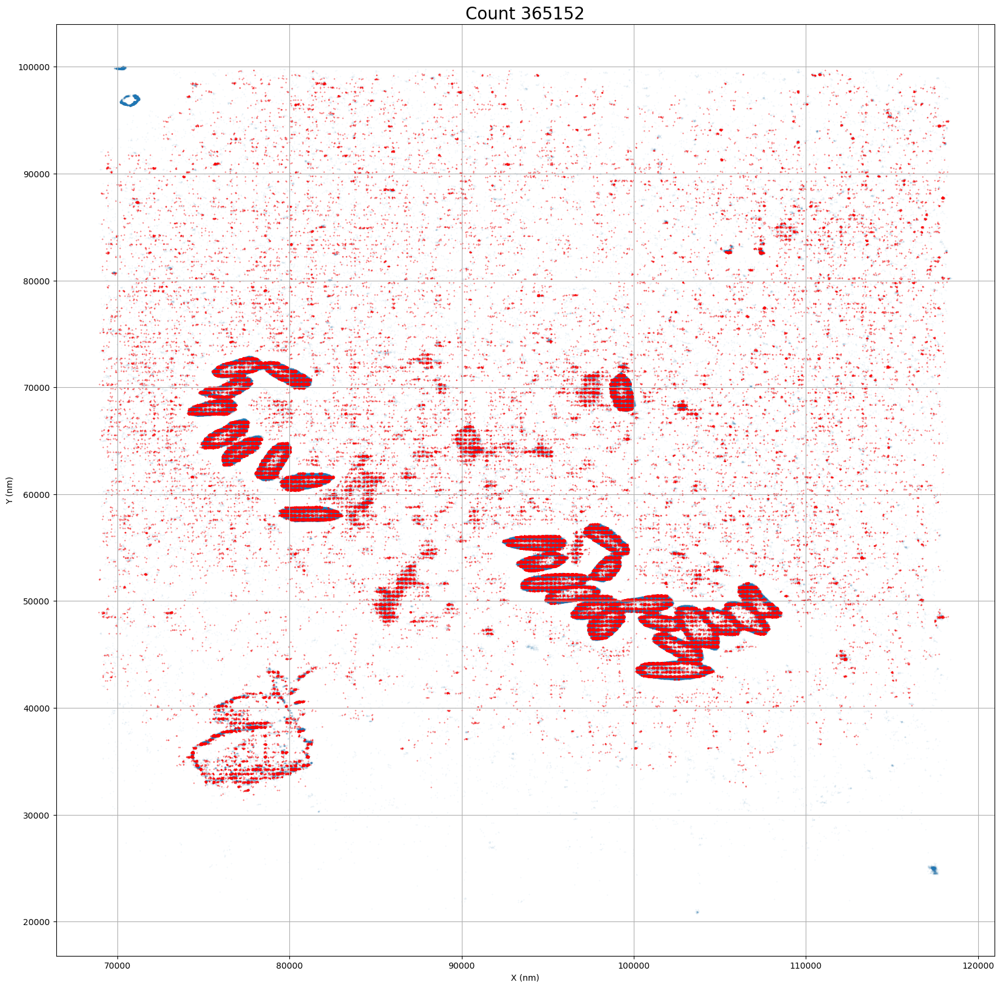

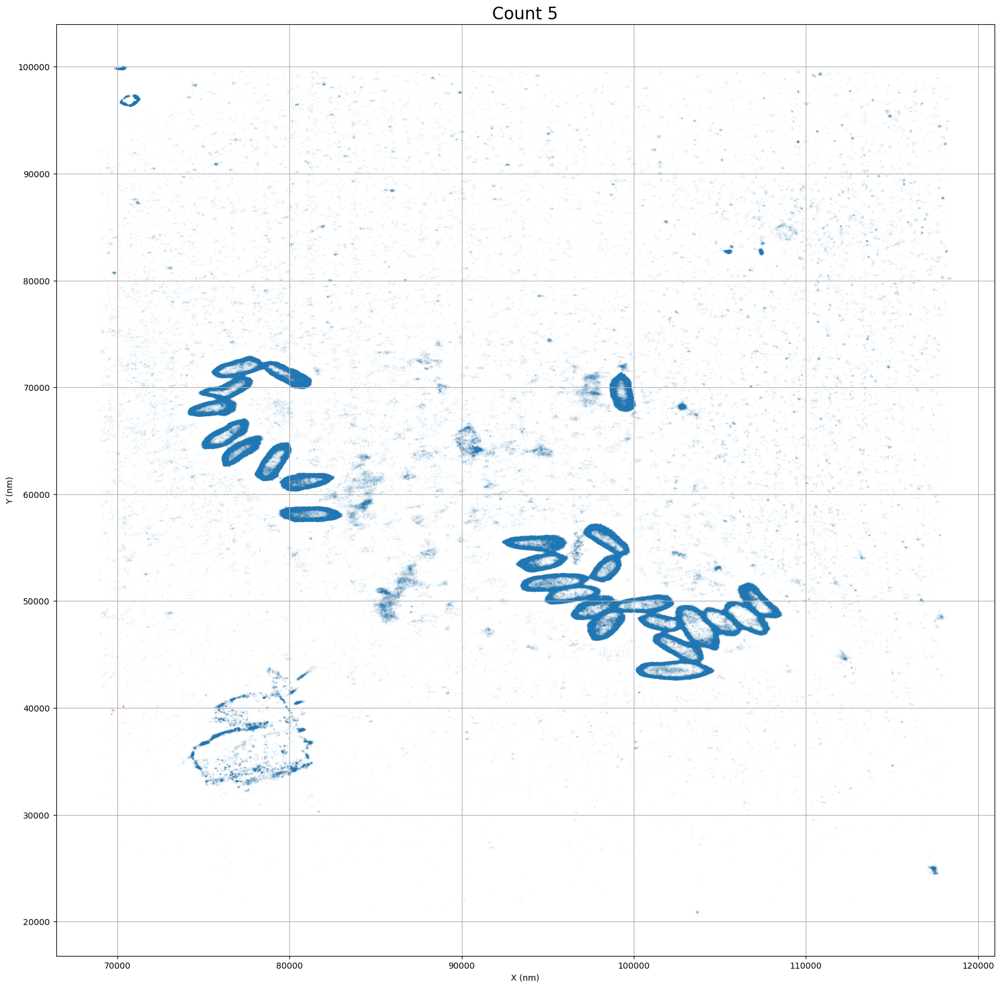

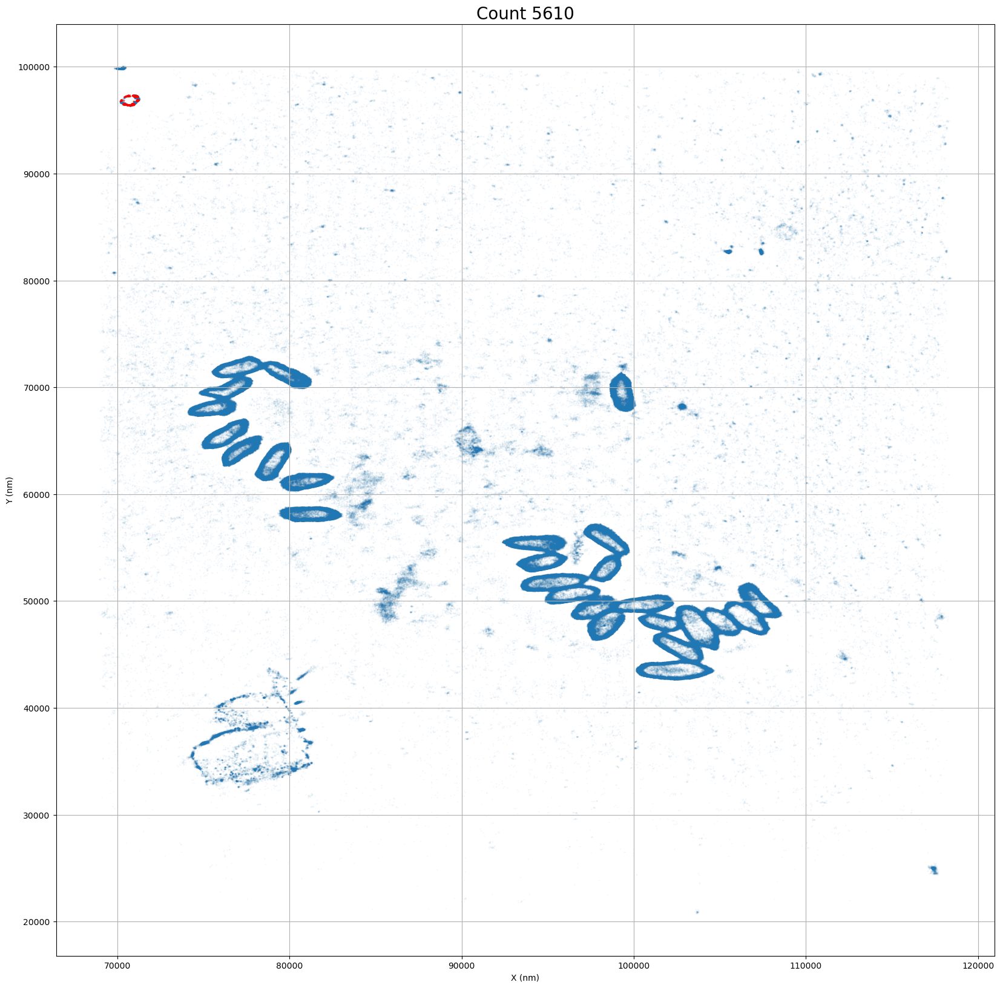

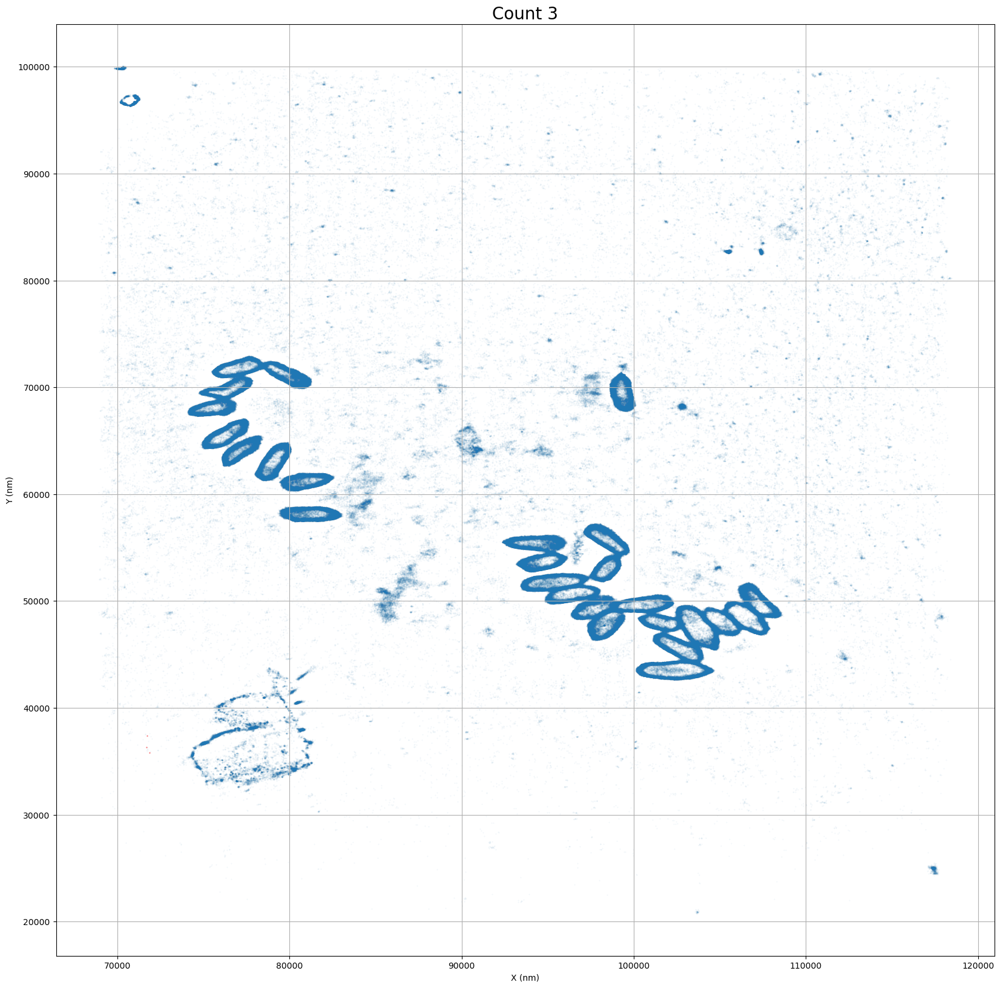

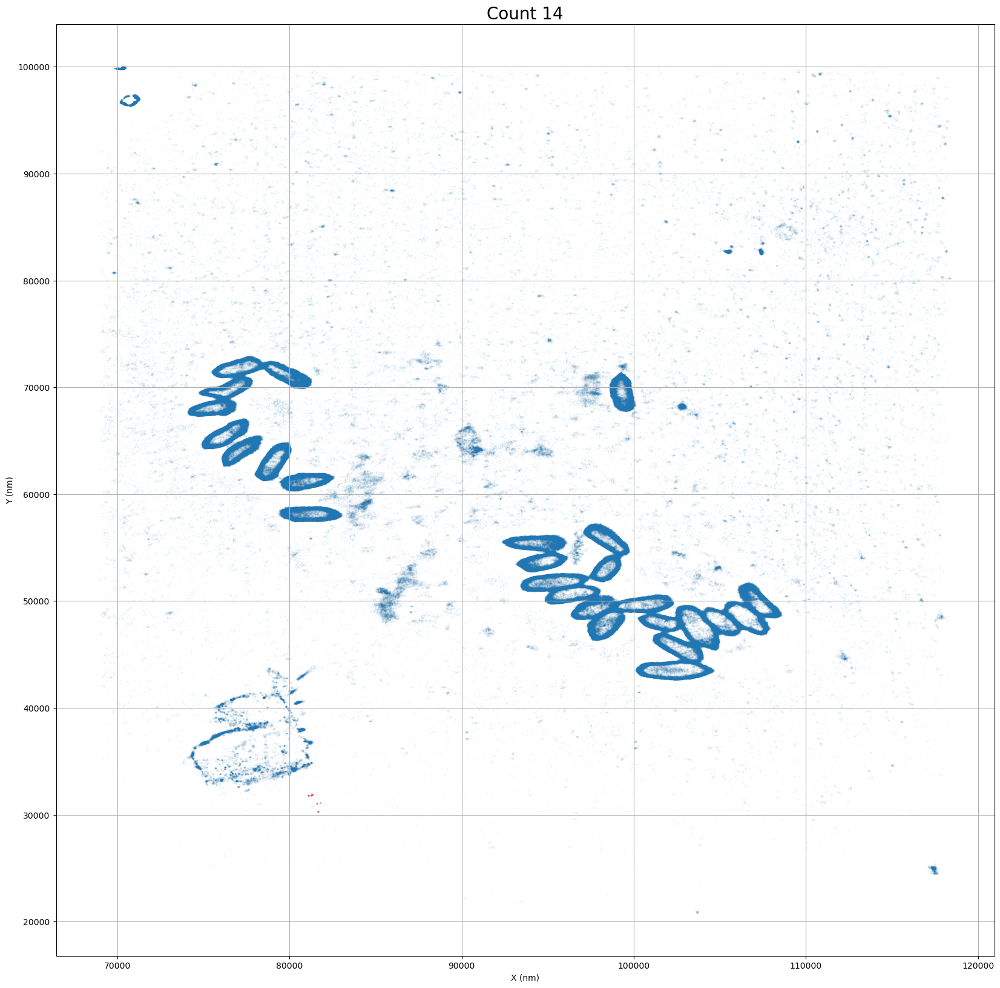

...

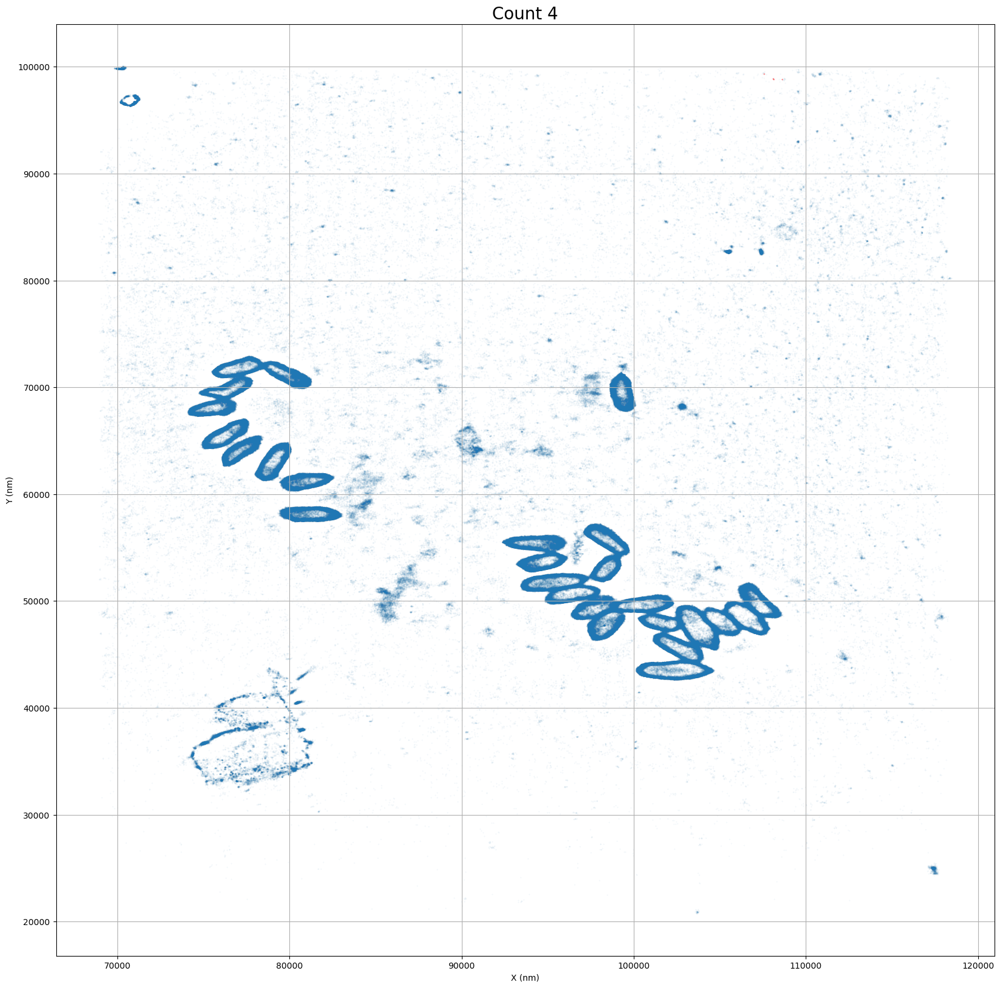

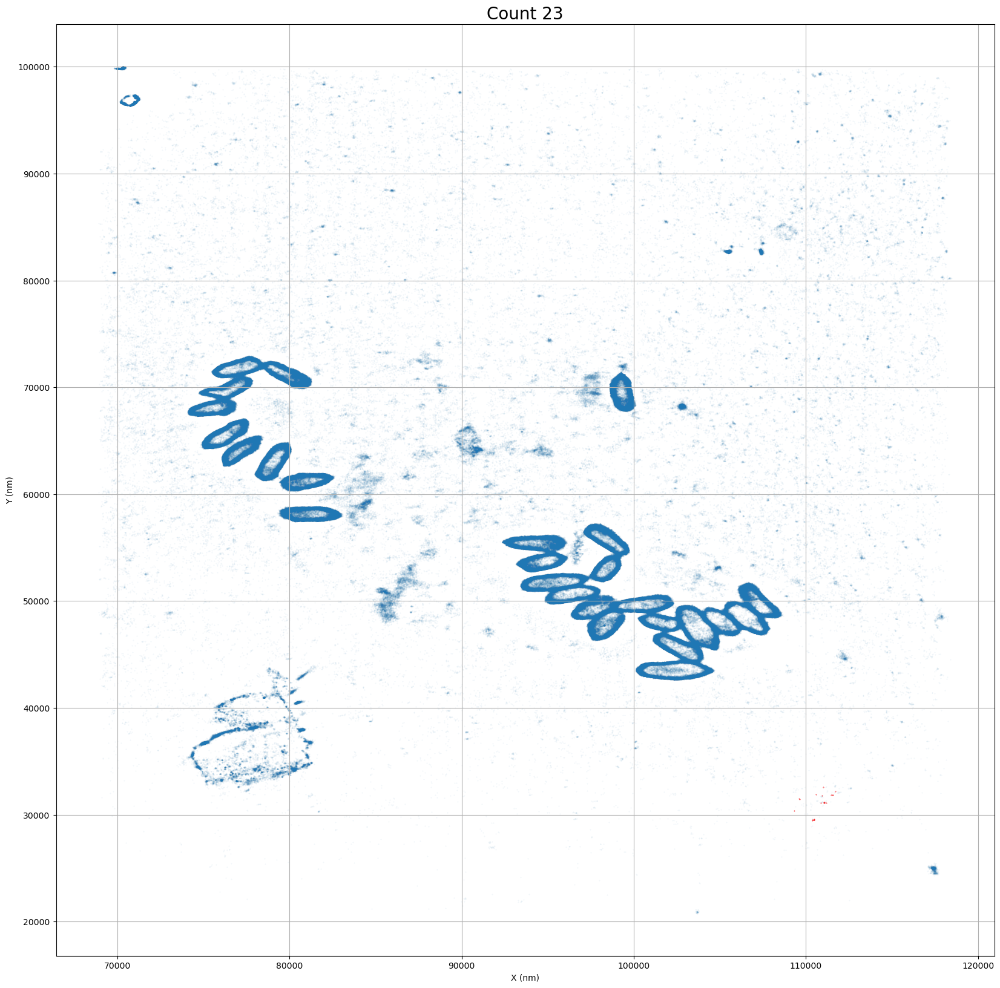

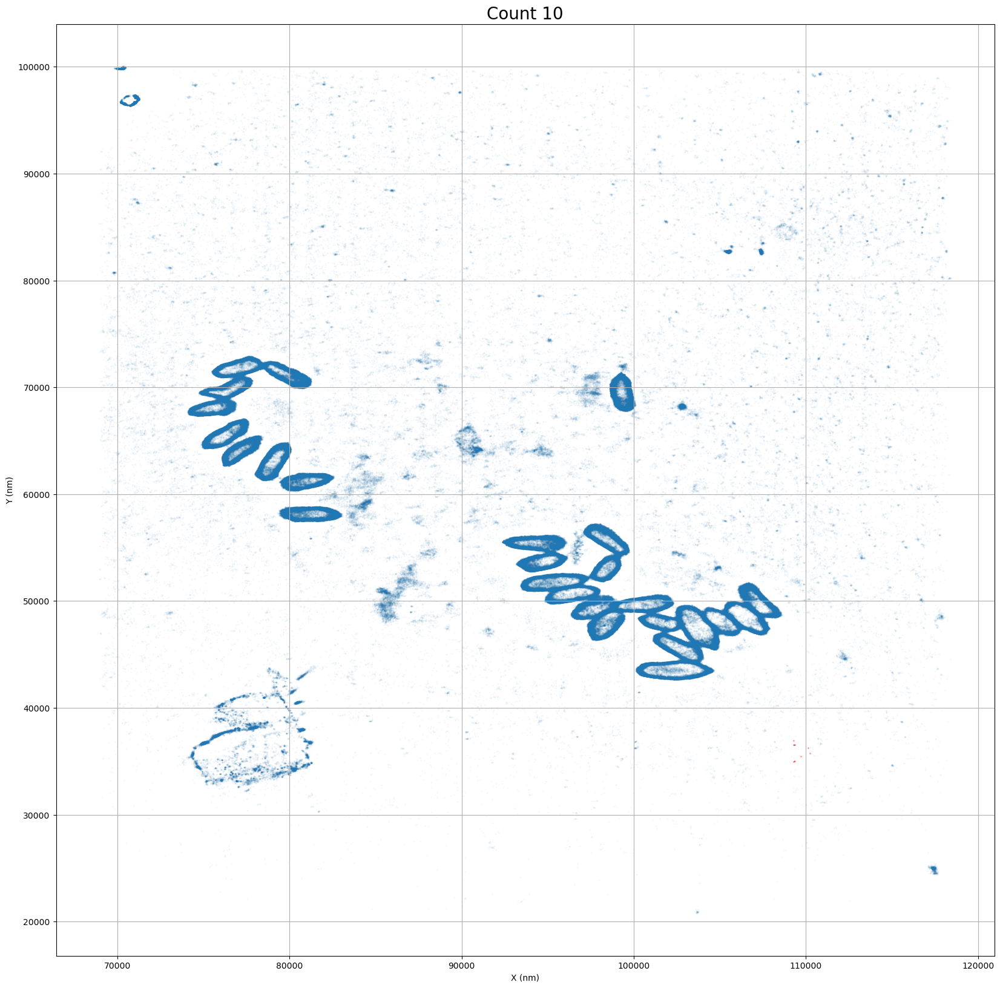

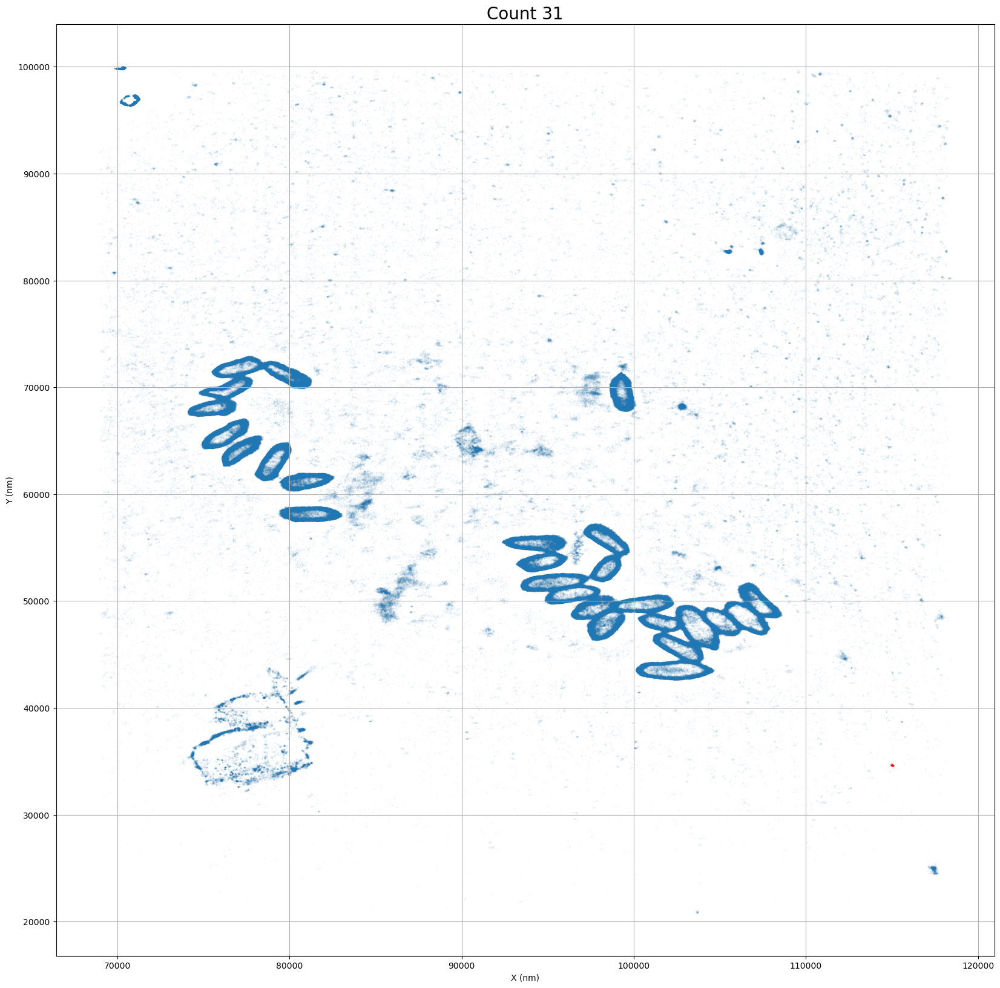

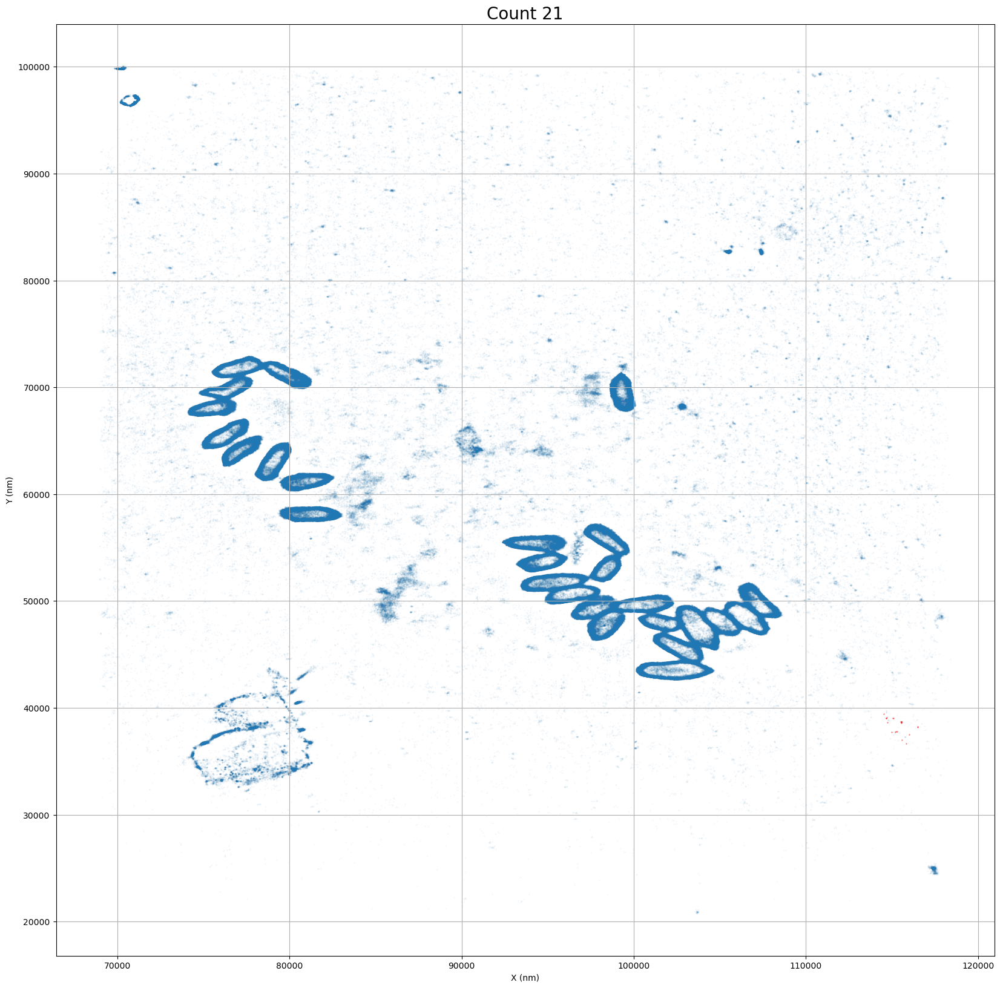

In [12]:
from scipy.spatial import cKDTree


from scipy.spatial import cKDTree

def find_nearby_points_chunked(dataset1, dataset2, radius, chunk_size=5000):
    """
    Find the points in dataset1 that are within a certain distance to at least
    one point in dataset2.
    
    Args:
    dataset1 (numpy.array): A 2D array where each row represents a point.
    dataset2 (numpy.array): A 2D array where each row represents a point.
    radius (float): The distance threshold.
    chunk_size (int): The number of points from dataset1 to process at a time.
    
    Returns:
    nearby_points (numpy.array): A 2D array where each row represents a point in dataset1 that is within the specified distance to at least one point in dataset2.
    """
    # Build a k-d tree for dataset2
    tree = cKDTree(dataset2)

    nearby_points = []

    # Split dataset1 into chunks to avoid using too much memory
    chunks = [dataset1[i:i+chunk_size] for i in range(0, len(dataset1), chunk_size)]

    for chunk in chunks:
        # Find the points in the chunk that are within the specified distance to at least one point in dataset2
        indices = tree.query_ball_point(chunk, r=radius)

        # Convert the list of indices to a Boolean mask
        mask = [bool(idx) for idx in indices]

        # Use the mask to select the nearby points
        nearby_points.extend(chunk[mask])
        #print("a")

    return np.array(nearby_points)


#coordinates_scaled=preprocess_coords(coordinates)
#contour_coordinates_scaled=preprocess_coords(contour_coordinates)
cell_real_coordinates=[]
cell_count=[]
# Plot each set of cell coordinates in a different color
colors = [(0, 0, 255), (0, 255, 0), (255, 0, 0), (255, 255, 0), (255, 0, 255), (0, 255, 255)]

for i, coordinate in enumerate(cell_grided_coordinates):
    cell_real_coordinates.append( np.array (find_nearby_points_chunked(coordinates,coordinate,100)) )
    cell_count.append(cell_real_coordinates[-1].shape[0])

    print(cell_real_coordinates[i].shape)
    plt.figure(figsize=(20, 20))
    plt.title("Count " + str(cell_real_coordinates[-1].shape[0]), fontsize=20)
    plt.xlabel('X (nm)')
    plt.ylabel('Y (nm)')
    plt.grid(True)
    plt.scatter(coordinates[:, 0], coordinates[:, 1], s=0.1, alpha=0.1)

    plt.scatter(cell_real_coordinates[-1][:, 0], cell_real_coordinates[-1][:, 1], c="red",s=0.1)
    plt.savefig("Cell " + str(i))

print("Media, " + str(sum(cell_count)/len(cell_count)))